# The two-dimensional wave equation

The wave equation is a second-order linear partial differential equation describing the behaviour of mechanical waves; its two (spatial) dimensional form can be used to describe waves on a surface of water:

$$ \frac{\partial^2 u}{\partial t^2} - c^2 \left( \frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2} \right) = 0 $$

To model such waves numerically, it is common to work with a discrete grid of spatial and time points and to approximate the partial derivatives using the method of finite differences. A simple approach is to take the central difference using neighbouring points on the grid. In one dimension, for a grid spacing of \( h \), the first and second derivatives are approximately:

$$ \frac{df}{dx} \approx \frac{f(x + \frac{h}{2}) - f(x - \frac{h}{2})}{h} $$

and

$$ \frac{d^2f}{dx^2} \approx \frac{f(x+h)-f(x)}{h} - \frac{f(x)-f(x-h)}{h} = \frac{f(x + h) - 2f(x) + f(x - h)}{h^2} $$

In two dimensions (assuming equal grid spacing in each direction), the most basic numerical approach is to use the five-point stencil:

$$ \frac{\partial^2 f}{\partial x^2} \approx \frac{f(x + h, y) - 2f(x, y) + f(x - h, y)}{h^2} $$

$$ \frac{\partial^2 f}{\partial y^2} \approx \frac{f(x, y + h) - 2f(x, y) + f(x, y - h)}{h^2} $$

Therefore, the procedure is to choose a spatial grid size, \( h \), and time step size, \( $\delta t$ \), and represent the function as:

$$ u(t; x, y) = u^{(k)}_{i,j} $$

where \( k \) labels the time step:

$$ u(t + \delta t; x, y) = u^{(k+1)}_{i,j} $$

and \( i \) and \( j \) the \( x \) and \( y \) coordinates of the spatial grid:

e.g.,

$$ u(t, x + h, y) = u^{(k)}_{i+1,j} $$

$$ u(t, x, y + h) = u^{(k)}_{i,j+1} $$

etc.

The above finite difference equations then approximate the wave equation as:

$$ \frac{1}{\delta t^2} \left( u^{(k+1)}_{i,j} - 2u^{(k)}_{i,j} + u^{(k-1)}_{i,j} \right) - \frac{c^2}{h^2} \left( u^{(k)}_{i+1,j} + u^{(k)}_{i-1,j} + u^{(k)}_{i,j+1} + u^{(k)}_{i,j-1} - 4u^{(k)}_{i,j} \right) = 0 $$

The goal of the simulation is to predict how the wave function \( u \) will evolve in time for each point on the spatial grid: i.e., to find \( $u^{(k+1)}_{i,j}$ \):

$$ u^{(k+1)}_{i,j} = \alpha^2 \left( u^{(k)}_{i+1,j} + u^{(k)}_{i-1,j} + u^{(k)}_{i,j+1} + u^{(k)}_{i,j-1} - 4u^{(k)}_{i,j} \right) + 2u^{(k)}_{i,j} - u^{(k-1)}_{i,j}, $$

where \( $\alpha = \frac{c \delta t}{h}$ \).

This would be the end of the story if the spatial grid had infinite extent, but in practice we have to choose a finite number of \( (x, y) \) points and therefore need to worry about what happens at the boundary of the grid. One choice is simply to fix the boundary values of the wave function to be zero:

$$ u_{0,j} = u_{i,0} = u_{N_x,j} = u_{i,N_y} = 0 $$


In [5]:
import numpy as np

class WaveEqn2D:
    def __init__(self, nx=500, ny=500, c=0.2, h=1, dt=1,
                 use_mur_abc=True):
        """Initialize the simulation:

        nx and ny are the dimension of the domain;
        c is the wave speed;
        h and dt are the space and time grid spacings;
        If use_mur_abc is True, the Mur absorbing boundary
        conditions will be used; if False, the Dirichlet
        (reflecting) boundary conditions are used.

        """

        self.nx, self.ny = nx, ny
        self.c = c
        self.h, self.dt = 1, 1
        self.use_mur_abc = use_mur_abc
        self.alpha = self.c * self.dt / self.h
        self.alpha2 = self.alpha**2

        self.u = np.zeros((3, ny, nx))

    def update(self):
        """Update the simulation by one time tick."""

        # The three planes of u correspond to the time points
        # k+1, k and k-1; i.e. we calculate the next frame
        # of the simulation (k+1) in u[0,...].
        u, nx, ny = self.u, self.nx, self.ny
        u[2] = u[1]     # old k -> new k-1
        u[1] = u[0]     # old k+1 -> new k

        # Calculate the new k+1:
        u[0, 1:ny-1, 1:nx-1]  = self.alpha2 * (
                    u[1, 0:ny-2, 1:nx-1]
                  + u[1, 2:ny,   1:nx-1]
                  + u[1, 1:ny-1, 0:nx-2]
                  + u[1, 1:ny-1, 2:nx]
                  - 4*u[1, 1:ny-1, 1:nx-1]) \
                  + (2 * u[1, 1:ny-1, 1:nx-1]
                  - u[2, 1:ny-1, 1:nx-1])

        if self.use_mur_abc:
            # Mur absorbing boundary conditions.
            kappa = (1 - self.alpha) / (1 + self.alpha) 
            u[0, 0, 1:nx-1] = (u[1, 1, 1:nx-1]
                               - kappa * (
                                     u[0, 1, 1:nx-1]
                                   - u[1, 0, 1:nx-1])
                              )
            u[0, ny-1, 1:nx-1] = (u[1, ny-2, 1:nx-1]
                               + kappa * (
                                   u[1, ny-1, 1:nx-1]
                                 - u[0, ny-2, 1:nx-1])
                              )
            u[0, 1:ny-1, 0] = (u[1, 1:ny-1, 1]
                               - kappa * (
                                   u[0, 1:ny-1, 1]
                               - u[1, 1:ny-1, 0])
                              )
            u[0, 1:ny-1, nx-1] = (u[1, 1:ny-1, nx-2]
                               + kappa * (
                                   u[1, 1:ny-1, nx-1]
                                 - u[0, 1:ny-1, nx-2])
                              )

Its use is illustrated below for modelling the waves produced by a signal, sinusoidally varying in time at the centre of the domain.

done


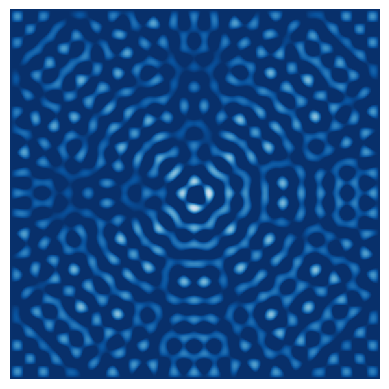

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
# from wave_eqn2d import WaveEqn2D

A = 80
dt = 1
T = 50
freq = 2 * np.pi / T
nx = ny = 200
sim = WaveEqn2D(nx, ny, dt=dt, use_mur_abc=False)

fig, ax = plt.subplots()
ax.axis("off")
img = ax.imshow(sim.u[0], vmin=0, vmax=40, cmap='Blues_r')

def update(i):
    """Advance the simulation by one tick."""
    # A regular sinusoidal signal at the centre of the domain.
    sim.u[0, ny//2, nx//2] = A * np.sin(i * freq)
    sim.update()

def init():
    """
    Initialization, because we're blitting and need references to the
    animated objects.
    """
    return img,

def animate(i):
    """Draw frame i of the animation."""
    update(i)
    img.set_data(sim.u[0])
    return img,

interval, nframes = sim.dt, 1500
ani = animation.FuncAnimation(fig, animate, frames=nframes,
                              repeat=False,
                              init_func=init, interval=interval, blit=True)# init_func for clear frame, blit for update changes only (blitting algorithm)

path = '../images/2d_wave_eq.gif'
ani.save(path, writer='pillow',fps=30,dpi=100)
print('done')

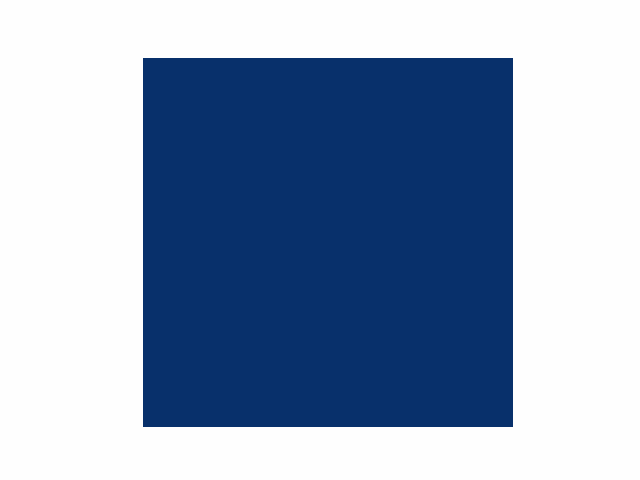

In [7]:
from IPython.display import Image
Image(filename = path) 